# Content-based Movie Recommender System

By - <a href = "https://www.linkedin.com/in/sougatdey/"> Sougat Dey </a>

## About Me

Hi, I'm Sougat Dey, an aspiring Data Scientist with a strong foundation in Python and Statistics. This project marks my first foray into the exciting world of Machine Learning, where I aim to apply my skills and knowledge to build a robust content-based movie recommender system. Through this project, I seek to not only showcase my technical abilities but also demonstrate a passion for leveraging data science to solve real-world problems. Join me on this journey as we explore the intricacies of recommendation algorithms and create a content-based movie recommendation experience for users.

#### Connect on <a href = "https://www.linkedin.com/in/sougatdey/"> LinkedIn </a>.

## Introduction

In today's world of endless streaming options, it's no wonder users often struggle to pick something to watch. Thankfully, **recommender systems** jump in to offer personalized suggestions based on your preferences and viewing habits, taking the guesswork out of your decision.

### What is a Recommender System?

A **recommender system** is a tool or algorithm that suggests items to users based on their interests and past interactions. These systems are widely used in various platforms like Amazon Prime, Netflix, Hulu, and others to enhance user experience and engagement.

### Types of Recommender Systems:

1. **Content-Based Recommender Systems:** These systems recommend items similar to those a user has liked or interacted with in the past. For movies, this could be based on genres, actors, directors, or plot keywords.

2. **Collaborative Filtering:** Collaborative filtering recommends items based on user behavior and preferences. It can be further divided into:
   - **User-Based Collaborative Filtering:** Recommends items based on similar users' preferences.
   - **Item-Based Collaborative Filtering:** Recommends items based on similarities between items.

3. **Hybrid Recommender Systems:** These systems combine multiple techniques, such as content-based and collaborative filtering, to provide more accurate and diverse recommendations.


**Note:** Since this project focuses on building a **content-based recommender system**, we will delve deeper into leveraging movie attributes such as genres, actors, directors, and plot keywords to provide personalized movie recommendations.


## 1. Importing Dependencies

In [1]:
## To process the data
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from io import StringIO
import string

## For data visualization
import matplotlib.pyplot as plt
import seaborn as sns

## Set the style to 'dark_background'
plt.style.use('ggplot')

## For stemming words in required columns
import nltk
from nltk.stem.porter import PorterStemmer

## Metric
from sklearn.metrics.pairwise import cosine_similarity, linear_kernel

## For fetching movie posters
import requests
from io import BytesIO
from PIL import Image
import matplotlib.image as mpimg

## For hiding warnings
import warnings
warnings.filterwarnings('ignore')

#### TMDb API Key
API Key = ```6700d8b244e37ebf55d8ff2c605c02ce```

## 2. Reading-in Required Datasets

In [2]:
## importing the movies dataset
moviesDF = pd.read_csv("/kaggle/input/tmdb-movie-metadata/tmdb_5000_movies.csv")

In [3]:
## importing the credits dataset
creditsDF = pd.read_csv("/kaggle/input/tmdb-movie-metadata/tmdb_5000_credits.csv")

## 3. Data Exploration (Initial)

In [4]:
## fetching the first three rows of `moviesDF`
moviesDF.head(3)

,budget,genres,homepage,id,keywords,original_language,original_title,overview,popularity,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,vote_average,vote_count
0,237000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://www.avatarmovie.com/,19995,"[{""id"": 1463, ""name"": ""culture clash""}, {""id"":...",en,Avatar,"In the 22nd century, a paraplegic Marine is di...",150.437577,"[{""name"": ""Ingenious Film Partners"", ""id"": 289...","[{""iso_3166_1"": ""US"", ""name"": ""United States o...",2009-12-10,2787965087,162.0,"[{""iso_639_1"": ""en"", ""name"": ""English""}, {""iso...",Released,Enter the World of Pandora.,Avatar,7.2,11800
1,300000000,"[{""id"": 12, ""name"": ""Adventure""}, {""id"": 14, ""...",http://disney.go.com/disneypictures/pirates/,285,"[{""id"": 270, ""name"": ""ocean""}, {""id"": 726, ""na...",en,Pirates of the Caribbean: At World's End,"Captain Barbossa, long believed to be dead, ha...",139.082615,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}, {""...","[{""iso_3166_1"": ""US"", ""name"": ""United States o...",2007-05-19,961000000,169.0,"[{""iso_639_1"": ""en"", ""name"": ""English""}]",Released,"At the end of the world, the adventure begins.",Pirates of the Caribbean: At World's End,6.9,4500
2,245000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://www.sonypictures.com/movies/spectre/,206647,"[{""id"": 470, ""name"": ""spy""}, {""id"": 818, ""name...",en,Spectre,A cryptic message from Bond’s past sends him o...,107.376788,"[{""name"": ""Columbia Pictures"", ""id"": 5}, {""nam...","[{""iso_3166_1"": ""GB"", ""name"": ""United Kingdom""...",2015-10-26,880674609,148.0,"[{""iso_639_1"": ""fr"", ""name"": ""Fran\u00e7ais""},...",Released,A Plan No One Escapes,Spectre,6.3,4466


In [5]:
## fetching the first three rows of `creditsDF`
creditsDF.head(3)

,movie_id,title,cast,crew
0,19995,Avatar,"[{""cast_id"": 242, ""character"": ""Jake Sully"", ""...","[{""credit_id"": ""52fe48009251416c750aca23"", ""de..."
1,285,Pirates of the Caribbean: At World's End,"[{""cast_id"": 4, ""character"": ""Captain Jack Spa...","[{""credit_id"": ""52fe4232c3a36847f800b579"", ""de..."
2,206647,Spectre,"[{""cast_id"": 1, ""character"": ""James Bond"", ""cr...","[{""credit_id"": ""54805967c3a36829b5002c41"", ""de..."


### 3.1. Merging `moviesDF` & `creditsDF` into one DataFrame

In [6]:
## merging two datasets
movies = moviesDF.merge(creditsDF, left_on = 'id', right_on = 'movie_id')

In [7]:
## fetching the first three rows of the newest DataFrame
movies.head(3)

,budget,genres,homepage,id,keywords,original_language,original_title,overview,popularity,production_companies,...,spoken_languages,status,tagline,title_x,vote_average,vote_count,movie_id,title_y,cast,crew
0,237000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://www.avatarmovie.com/,19995,"[{""id"": 1463, ""name"": ""culture clash""}, {""id"":...",en,Avatar,"In the 22nd century, a paraplegic Marine is di...",150.437577,"[{""name"": ""Ingenious Film Partners"", ""id"": 289...",...,"[{""iso_639_1"": ""en"", ""name"": ""English""}, {""iso...",Released,Enter the World of Pandora.,Avatar,7.2,11800,19995,Avatar,"[{""cast_id"": 242, ""character"": ""Jake Sully"", ""...","[{""credit_id"": ""52fe48009251416c750aca23"", ""de..."
1,300000000,"[{""id"": 12, ""name"": ""Adventure""}, {""id"": 14, ""...",http://disney.go.com/disneypictures/pirates/,285,"[{""id"": 270, ""name"": ""ocean""}, {""id"": 726, ""na...",en,Pirates of the Caribbean: At World's End,"Captain Barbossa, long believed to be dead, ha...",139.082615,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}, {""...",...,"[{""iso_639_1"": ""en"", ""name"": ""English""}]",Released,"At the end of the world, the adventure begins.",Pirates of the Caribbean: At World's End,6.9,4500,285,Pirates of the Caribbean: At World's End,"[{""cast_id"": 4, ""character"": ""Captain Jack Spa...","[{""credit_id"": ""52fe4232c3a36847f800b579"", ""de..."
2,245000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://www.sonypictures.com/movies/spectre/,206647,"[{""id"": 470, ""name"": ""spy""}, {""id"": 818, ""name...",en,Spectre,A cryptic message from Bond’s past sends him o...,107.376788,"[{""name"": ""Columbia Pictures"", ""id"": 5}, {""nam...",...,"[{""iso_639_1"": ""fr"", ""name"": ""Fran\u00e7ais""},...",Released,A Plan No One Escapes,Spectre,6.3,4466,206647,Spectre,"[{""cast_id"": 1, ""character"": ""James Bond"", ""cr...","[{""credit_id"": ""54805967c3a36829b5002c41"", ""de..."


In [8]:
## checking the shape of the newest DataFrame
movies.shape

(4803, 24)

In [9]:
## fetching the summary of the DataFrame
movies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4803 entries, 0 to 4802
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   budget                4803 non-null   int64  
 1   genres                4803 non-null   object 
 2   homepage              1712 non-null   object 
 3   id                    4803 non-null   int64  
 4   keywords              4803 non-null   object 
 5   original_language     4803 non-null   object 
 6   original_title        4803 non-null   object 
 7   overview              4800 non-null   object 
 8   popularity            4803 non-null   float64
 9   production_companies  4803 non-null   object 
 10  production_countries  4803 non-null   object 
 11  release_date          4802 non-null   object 
 12  revenue               4803 non-null   int64  
 13  runtime               4801 non-null   float64
 14  spoken_languages      4803 non-null   object 
 15  status               

In [10]:
## fetching statistical information for each column (except for column with dtype "object")
## transposed for readability
np.round(movies.drop(["id", 'movie_id'], axis = 1).select_dtypes(exclude=['object']).describe().transpose(),3)

,count,mean,std,min,25%,50%,75%,max
budget,4803.0,2.904504e+07,4.072239e+07,0.0,790000.000,1.500000e+07,4.000000e+07,3.800000e+08
popularity,4803.0,2.149200e+01,3.181700e+01,0.0,4.668,1.292200e+01,2.831400e+01,8.755810e+02
revenue,4803.0,8.226064e+07,1.628571e+08,0.0,0.000,1.917000e+07,9.291719e+07,2.787965e+09
runtime,4801.0,1.068760e+02,2.261200e+01,0.0,94.000,1.030000e+02,1.180000e+02,3.380000e+02
vote_average,4803.0,6.092000e+00,1.195000e+00,0.0,5.600,6.200000e+00,6.800000e+00,1.000000e+01
vote_count,4803.0,6.902180e+02,1.234586e+03,0.0,54.000,2.350000e+02,7.370000e+02,1.375200e+04


In [11]:
## fetching number of `NULL` values for each column
movies.isnull().sum()

budget                     0
genres                     0
homepage                3091
id                         0
keywords                   0
original_language          0
original_title             0
overview                   3
popularity                 0
production_companies       0
production_countries       0
release_date               1
revenue                    0
runtime                    2
spoken_languages           0
status                     0
tagline                  844
title_x                    0
vote_average               0
vote_count                 0
movie_id                   0
title_y                    0
cast                       0
crew                       0
dtype: int64

In [12]:
## fetching number of `duplicated` rows for the entire DataFrame
movies.duplicated().sum()

0

In [13]:
## fetching number of `duplicated` rows for each column
for column in movies.columns:
    print(f"{column} : {movies.duplicated(subset=column, keep='first').sum()}")

budget : 4367
genres : 3628
homepage : 3111
id : 0
keywords : 581
original_language : 4766
original_title : 2
overview : 2
popularity : 1
production_companies : 1106
production_countries : 4334
release_date : 1522
revenue : 1506
runtime : 4646
spoken_languages : 4259
status : 4800
tagline : 858
title_x : 3
vote_average : 4732
vote_count : 3194
movie_id : 0
title_y : 3
cast : 42
crew : 27


#### *Note*: We'll get back to dealing with duplicate rows when final data preparation is done.

## 4. Data Preparation

##### *Note:* Since not all these columns will help achieve our best interest to build a Movie Recommender System, we will have to take a subset of the relevant columns.

In [14]:
## taking only selected columns
movies = movies[['movie_id', 'title_x', 'genres', 'overview', 'keywords', 'release_date', 'cast', 'crew', 'vote_average', 'vote_count', 'production_companies', 'budget', 'revenue']].rename(columns = {'title_x':'title'})

In [15]:
## fetching the head of the DataFrame
movies.head()

,movie_id,title,genres,overview,keywords,release_date,cast,crew,vote_average,vote_count,production_companies,budget,revenue
0,19995,Avatar,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...","In the 22nd century, a paraplegic Marine is di...","[{""id"": 1463, ""name"": ""culture clash""}, {""id"":...",2009-12-10,"[{""cast_id"": 242, ""character"": ""Jake Sully"", ""...","[{""credit_id"": ""52fe48009251416c750aca23"", ""de...",7.2,11800,"[{""name"": ""Ingenious Film Partners"", ""id"": 289...",237000000,2787965087
1,285,Pirates of the Caribbean: At World's End,"[{""id"": 12, ""name"": ""Adventure""}, {""id"": 14, ""...","Captain Barbossa, long believed to be dead, ha...","[{""id"": 270, ""name"": ""ocean""}, {""id"": 726, ""na...",2007-05-19,"[{""cast_id"": 4, ""character"": ""Captain Jack Spa...","[{""credit_id"": ""52fe4232c3a36847f800b579"", ""de...",6.9,4500,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}, {""...",300000000,961000000
2,206647,Spectre,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",A cryptic message from Bond’s past sends him o...,"[{""id"": 470, ""name"": ""spy""}, {""id"": 818, ""name...",2015-10-26,"[{""cast_id"": 1, ""character"": ""James Bond"", ""cr...","[{""credit_id"": ""54805967c3a36829b5002c41"", ""de...",6.3,4466,"[{""name"": ""Columbia Pictures"", ""id"": 5}, {""nam...",245000000,880674609
3,49026,The Dark Knight Rises,"[{""id"": 28, ""name"": ""Action""}, {""id"": 80, ""nam...",Following the death of District Attorney Harve...,"[{""id"": 849, ""name"": ""dc comics""}, {""id"": 853,...",2012-07-16,"[{""cast_id"": 2, ""character"": ""Bruce Wayne / Ba...","[{""credit_id"": ""52fe4781c3a36847f81398c3"", ""de...",7.6,9106,"[{""name"": ""Legendary Pictures"", ""id"": 923}, {""...",250000000,1084939099
4,49529,John Carter,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...","John Carter is a war-weary, former military ca...","[{""id"": 818, ""name"": ""based on novel""}, {""id"":...",2012-03-07,"[{""cast_id"": 5, ""character"": ""John Carter"", ""c...","[{""credit_id"": ""52fe479ac3a36847f813eaa3"", ""de...",6.1,2124,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}]",260000000,284139100


In [16]:
## fetching number of `NULL` values for each column
movies.isnull().sum()

movie_id                0
title                   0
genres                  0
overview                3
keywords                0
release_date            1
cast                    0
crew                    0
vote_average            0
vote_count              0
production_companies    0
budget                  0
revenue                 0
dtype: int64

In [17]:
## fetching number of duplicated for each column
for column in movies.drop(['genres', 'release_date'], axis=1).columns:
    print(f"{column} : {movies.drop(['genres', 'release_date'], axis=1).duplicated(subset=column, keep='first').sum()}")

movie_id : 0
title : 3
overview : 2
keywords : 581
cast : 42
crew : 27
vote_average : 4732
vote_count : 3194
production_companies : 1106
budget : 4367
revenue : 1506


### Issues with the dataset
1. It has `NULL` values in `overview` and `release_date`. Although `NULL` values `release_date` isn't much of a problem but one of key columns we'll use for our recommender system is `overview`. Hence, we'll have to deal with it.
2. We can see there are duplicated rows if we take subsets of a few specific columns. Although for a few columns it can be possible like `keywords`, `vote_average` etc., it's cruicial that we take a sincere look at columns like `title`, `cast` and `crew` for this particular issue. Because having `cast` or `crew` exactly same for more than one title is nearly impossible.

### 4.1. Dealing with `NULL` values

#### 4.1.1. Checking rows with `Nan` values in `overview` column. 

In [18]:
## fetching rows with `NULL` value in the `overview` column
movies[movies['overview'].isnull()]

,movie_id,title,genres,overview,keywords,release_date,cast,crew,vote_average,vote_count,production_companies,budget,revenue
2656,370980,Chiamatemi Francesco - Il Papa della gente,"[{""id"": 18, ""name"": ""Drama""}]",NaN,"[{""id"": 717, ""name"": ""pope""}, {""id"": 5565, ""na...",2015-12-03,"[{""cast_id"": 5, ""character"": ""Jorge Mario Berg...","[{""credit_id"": ""5660019ac3a36875f100252b"", ""de...",7.3,12,"[{""name"": ""Taodue Film"", ""id"": 45724}]",15000000,0
4140,459488,"To Be Frank, Sinatra at 100","[{""id"": 99, ""name"": ""Documentary""}]",NaN,"[{""id"": 6027, ""name"": ""music""}, {""id"": 225822,...",2015-12-12,"[{""cast_id"": 0, ""character"": ""Narrator"", ""cred...","[{""credit_id"": ""592b25e4c3a368783e065a2f"", ""de...",0.0,0,"[{""name"": ""Eyeline Entertainment"", ""id"": 60343}]",2,0
4431,292539,Food Chains,"[{""id"": 99, ""name"": ""Documentary""}]",NaN,[],2014-04-26,[],"[{""credit_id"": ""5470c3b1c3a368085e000abd"", ""de...",7.4,8,[],913000,0


#### Since the `RECOMMENDER SYSTEM` will be primarily based on the tags related to that particular movie, the `overview` plays a huge role capturing the actual essence of the movie. We can't keep rows with `NaN` values in the `overview` column. Hence, we will - 
1. drop the rows with `NULL` values in `overview` column
2. reset the index for further process

In [19]:
## removing rows that have `NULL` values in the `overview` column
movies.dropna(subset=['overview'], inplace=True)

In [20]:
## resetting the index
movies.reset_index(drop=True, inplace = True)

In [21]:
## Checking number of NULL values to deal with
movies.isnull().sum()

movie_id                0
title                   0
genres                  0
overview                0
keywords                0
release_date            1
cast                    0
crew                    0
vote_average            0
vote_count              0
production_companies    0
budget                  0
revenue                 0
dtype: int64

#### 4.1.2 Checking rows with `NULL` values in `release_date` column. 

In [22]:
## removing rows that have `NULL` values in the `release_date` column
movies[movies['release_date'].isnull()]

,movie_id,title,genres,overview,keywords,release_date,cast,crew,vote_average,vote_count,production_companies,budget,revenue
4550,380097,America Is Still the Place,[],1971 post civil rights San Francisco seemed li...,[],NaN,[],[],0.0,0,[],0,0


#### As we can see, most of the columns have empty values for this title. Hence, it's better to drop the entire row and reset the index.

In [23]:
## dropping rows with NULL values in `release_date`
movies.dropna(subset=['release_date'], inplace=True)

In [24]:
## resetting the index
movies.reset_index(drop=True, inplace = True)

In [25]:
## Checking if there is any `NULL` value left to deal with
movies.isnull().sum()

movie_id                0
title                   0
genres                  0
overview                0
keywords                0
release_date            0
cast                    0
crew                    0
vote_average            0
vote_count              0
production_companies    0
budget                  0
revenue                 0
dtype: int64

In [26]:
## Checking the shape of the dataframe
movies.shape

(4799, 13)

*Note:* Before we deal with the duplicated rows, it's better to transform the data into a readable format.

### 4.2. Text Extraction from JSON data

In [27]:
## fetching the first three titles of the DataFrame
movies.head(3)

,movie_id,title,genres,overview,keywords,release_date,cast,crew,vote_average,vote_count,production_companies,budget,revenue
0,19995,Avatar,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...","In the 22nd century, a paraplegic Marine is di...","[{""id"": 1463, ""name"": ""culture clash""}, {""id"":...",2009-12-10,"[{""cast_id"": 242, ""character"": ""Jake Sully"", ""...","[{""credit_id"": ""52fe48009251416c750aca23"", ""de...",7.2,11800,"[{""name"": ""Ingenious Film Partners"", ""id"": 289...",237000000,2787965087
1,285,Pirates of the Caribbean: At World's End,"[{""id"": 12, ""name"": ""Adventure""}, {""id"": 14, ""...","Captain Barbossa, long believed to be dead, ha...","[{""id"": 270, ""name"": ""ocean""}, {""id"": 726, ""na...",2007-05-19,"[{""cast_id"": 4, ""character"": ""Captain Jack Spa...","[{""credit_id"": ""52fe4232c3a36847f800b579"", ""de...",6.9,4500,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}, {""...",300000000,961000000
2,206647,Spectre,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",A cryptic message from Bond’s past sends him o...,"[{""id"": 470, ""name"": ""spy""}, {""id"": 818, ""name...",2015-10-26,"[{""cast_id"": 1, ""character"": ""James Bond"", ""cr...","[{""credit_id"": ""54805967c3a36829b5002c41"", ""de...",6.3,4466,"[{""name"": ""Columbia Pictures"", ""id"": 5}, {""nam...",245000000,880674609


#### - Looks like in `genres`, `keywords`, `cast`, `crew` and `production_companies` columns, storede data are of JSON format.

In [28]:
## fetching the `genres` data for the first title
movies['genres'].iloc[0]

'[{"id": 28, "name": "Action"}, {"id": 12, "name": "Adventure"}, {"id": 14, "name": "Fantasy"}, {"id": 878, "name": "Science Fiction"}]'

In [29]:
## fetching the `cast` data for the first title
# movies['cast'].iloc[0]

In [30]:
## fetching the `crew` data for the first title
# movies['crew'].iloc[0]

In [31]:
## fetching the `production_companies` data for the first title
movies['production_companies'].iloc[0]

'[{"name": "Ingenious Film Partners", "id": 289}, {"name": "Twentieth Century Fox Film Corporation", "id": 306}, {"name": "Dune Entertainment", "id": 444}, {"name": "Lightstorm Entertainment", "id": 574}]'

In [32]:
## fetching a random title from the DataFrame
movies.sample(1)

,movie_id,title,genres,overview,keywords,release_date,cast,crew,vote_average,vote_count,production_companies,budget,revenue
1456,9702,Bound by Honor,"[{""id"": 28, ""name"": ""Action""}, {""id"": 80, ""nam...",Based on the true life experiences of poet Jim...,"[{""id"": 2400, ""name"": ""juvenile prison""}, {""id...",1993-02-05,"[{""cast_id"": 1, ""character"": ""Miklo"", ""credit_...","[{""credit_id"": ""52fe451ec3a36847f80bd943"", ""de...",7.7,115,"[{""name"": ""Hollywood Pictures"", ""id"": 915}]",35000000,0


**Observations** -
1. In `genres`, `keyword`, `cast`, `crew` and `production_companies`, data is store in a JSON encapsulated format.
2. Both `cast` & `crew` have entire cast and crew information for a particular title.

**Task**
1. Convert the JSON data into a list of strings so that we can use it later.
2. We'll pick only top three cast members. Such a way we get to pick only the actors who played the lead and supporting roles for a particular title.
3. From `crew`, we'll pick the `director`.
4. For the rest of the column, we'll extract the entire data.

In [33]:
## function to unpack JSON data from keywords, production company & genres columns
def unpackingJSON(row, column_name):
    try:
        return pd.read_json(StringIO(row[column_name]))['name'].to_list()
    ## for those title where the data is not available, we'll return a list of a blank string
    except:
        return [""]

In [34]:
## unpacking JSONs to meaningful text data for columns -> keywords, production company, genres
for column in ['keywords', 'production_companies', 'genres']:
    movies[column] = movies.apply(unpackingJSON, column_name = column, axis=1)

In [35]:
## function to unpack Actors who played top 3 characters in the movie
def castUnpacking(row):
    try:
        return pd.read_json(StringIO(row))['name'].head(3).to_list()
    ## for those title where the data is not available, we'll return a list of a blank string
    except:
        return [""]

In [36]:
## applying the earlier function to unpack data from `cast`
movies['cast'] = movies['cast'].apply(castUnpacking)

In [37]:
## function to unpack the name of the DIRECTOR of the movie
def dircUnpacking(row):
    try:
        return pd.read_json(StringIO(row)).query('job == "Director"')['name'].to_list()
    ## for those title where the data is not available, we'll return a list of a blank string
    except:
        return ['']

In [38]:
## applying the earlier function to unpack data from `director`
movies['director'] = movies.crew.apply(dircUnpacking)

In [39]:
## dropping the `crew` column (since we'll consider the `director`)
movies.drop(['crew'], axis=1, inplace=True)

In [40]:
## fetching a random title to confirm all unpacking is done
movies.sample(1)

,movie_id,title,genres,overview,keywords,release_date,cast,vote_average,vote_count,production_companies,budget,revenue,director
2021,13680,The Game Plan,"[Comedy, Family]",Bachelor football star Joe Kingman seems to ha...,"[american football, bachelor, sports team, spo...",2007-09-28,"[Dwayne Johnson, Madison Pettis, Kyra Sedgwick]",6.0,428,"[Walt Disney Pictures, Mayhem Pictures, Monkey...",22000000,147880543,[Andy Fickman]


**Note:** Exact release date of a title might not be that important to our `RECOMMENDER SYSTEM` but `release_year` could help.

In [41]:
## Extracting YEAR from the `release_date` column and making a `release_year` column
movies['release_year'] = pd.to_datetime(movies['release_date']).dt.year

In [42]:
## dropping the `release_date` column
movies.drop('release_date', axis=1, inplace=True)

In [43]:
## fetching the first row
movies.head(1)

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year
0,19995,Avatar,"[Action, Adventure, Fantasy, Science Fiction]","In the 22nd century, a paraplegic Marine is di...","[culture clash, future, space war, space colon...","[Sam Worthington, Zoe Saldana, Sigourney Weaver]",7.2,11800,"[Ingenious Film Partners, Twentieth Century Fo...",237000000,2787965087,[James Cameron],2009


In [44]:
## checking if there is any title that has a list of blank string in `overview`
movies[movies.overview.apply(lambda x: x == [""])]

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year


In [45]:
## checking if there is any title that has a list of blank string in `keywords`
movies[movies.keywords.apply(lambda x: x == [""])]

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year
71,1735,The Mummy: Tomb of the Dragon Emperor,"[Adventure, Action, Fantasy]","Archaeologist Rick O'Connell travels to China,...",[],"[Brendan Fraser, Jet Li, John Hannah]",5.2,1387,"[Universal Pictures, China Film Co-Production ...",145000000,401128639,[Rob Cohen],2008
83,79698,The Lovers,"[Action, Adventure, Science Fiction, Romance]",The Lovers is an epic romance time travel adve...,[],"[Josh Hartnett, Simone Kessell, Tamsin Egerton]",4.8,34,"[Corsan, Bliss Media, Limelight International ...",27000000,0,[Roland Joffé],2015
323,37786,Sex and the City 2,"[Comedy, Drama, Romance]","Carrie, Charlotte, and Miranda are all married...",[],"[Sarah Jessica Parker, Kristin Davis, Cynthia ...",5.4,426,"[New Line Cinema, Village Roadshow Pictures, H...",100000000,288347692,[Michael Patrick King],2010
381,49852,The Nutcracker: The Untold Story,"[Fantasy, Action, Family]","Set in 1920's Vienna, this a tale of a little ...",[],"[Elle Fanning, Nathan Lane, John Turturro]",5.4,50,"[Vnesheconombank, Nutcracker Holdings, HCC Med...",90000000,16178959,[Andrei Konchalovsky],2010
436,109418,Grown Ups 2,[Comedy],The all-star comedy cast from Grown Ups return...,[],"[Adam Sandler, Kevin James, Chris Rock]",5.8,1155,"[Columbia Pictures, Happy Madison Productions,...",80000000,246984278,[Dennis Dugan],2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4786,13898,The Circle,"[Drama, Foreign]",Various women struggle to function in the oppr...,[],"[Nargess Mamizadeh, Maryiam Palvin Almani, Moj...",6.6,17,[Jafar Panahi Film Productions],0,0,[Jafar Panahi],2000
4790,286939,Sanctuary: Quite a Conundrum,"[Thriller, Horror, Comedy]","It should have been just a normal day of sex, ...",[],"[Sasha Ramos, Erin Cline, Emily Rogers]",0.0,0,"[Gold Lion Films, T-Street Productions]",0,0,[Thomas L. Phillips],2012
4793,67238,Cavite,"[Foreign, Thriller]","Adam, a security guard, travels from Californi...",[],[],7.5,2,[],0,0,"[Neill Dela Llana, Ian Gamazon]",2005
4795,72766,Newlyweds,"[Comedy, Romance]",A newlywed couple's honeymoon is upended by th...,[],"[Edward Burns, Kerry Bishé, Marsha Dietlein]",5.9,5,[],9000,0,[Edward Burns],2011


**Note**: Unfortunately, 410 movie titles have no keywords. Since `overview` and `keywords` of a title are primarily responsible to help us a find movie that has a similar storyline, we cannot afford having titles with missing `keywords.

In [46]:
## dropping movies with blank keywords
movies.drop(movies[movies.keywords.apply(lambda x: x == [""])].index, inplace = True)

In [47]:
## resetting index
movies.reset_index(drop = True, inplace = True)

#### We're done with extracting data from respective columns. Now, we have to deal with two other problems - 
1. There are spaces between words in all columns which will for sure lead to a confusion e.g. - `Christopher McQuarrie` & `Christopher Nolan` both share the first name `Christopher`. But when we'll transform our text data into vectors, it'll consider the count for `Christopher` not for `Christopher McQuarrie` & `Christopher Nolan` separately. That's why we have to make `christophermcquarrie` & `christophernolan` two separate words.
2. `overview` column includes punctuations. 
3. Words like `romance` & `romantic` will be treated as separate entities when we'll transform our text data into vectors.

**Tasks**
1. If we remove spaces between words and then split on `,` during the final concatenation of text, it will solve our first issue. 
2. We have to get rid of punctuations in `overview` column to generalize the model and convert it to a list of strings like other columns.
3. Also, we have to perform **STEMMING** to avoid confusion of words described in the third issue. One can read more about stemming <a href = "https://saturncloud.io/glossary/stemming/#:~:text=Stemming%20is%20a,forms%20are%20different."> here. </a>

### 4.4. Dealing with `overview` column

In [48]:
## creating an instance of PorterStemmer which we'll use for stemming words in `overview`
ps = PorterStemmer()

In [49]:
## list(string.punctuation) -> is a list of commonly used punctuations
## here, first we're creating a list of characters removing the punctuation characters
## then joining back for forming words
## then splitting each word on space and
## formed a list of words stemming each word
def overviewColTransformation(row):
    return [ps.stem(word) for word in "".join([letter for letter in list(row) if letter not in list(string.punctuation)]).lower().split(" ")]

In [50]:
## transforming the `overview` column
movies['overview'] = movies['overview'].apply(overviewColTransformation)

### 4.5. Dealing the similar issue for other columns

In [51]:
## fetching a random title
movies.sample(1)

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year
68,1726,Iron Man,"[Action, Science Fiction, Adventure]","[after, be, held, captiv, in, an, afghan, cave...","[middle east, arms dealer, malibu, marvel comi...","[Robert Downey Jr., Terrence Howard, Jeff Brid...",7.4,8776,[Marvel Studios],140000000,585174222,[Jon Favreau],2008


In [52]:
## lowering and removing in between space for respective columns
for column in ['genres', 'cast', 'production_companies', 'director', 'keywords']:
    if column != 'keywords':
        movies[column] = movies[column].apply(lambda x: [item.lower().replace(" ", "") for item in x])
    else:
        movies['keywords'].apply(lambda x: [ps.stem(item.replace(" ","")) for item in x])

In [53]:
## fetching first three titles to ensure the earlier transformation is done correctly
movies.head(3)

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year
0,19995,Avatar,"[action, adventure, fantasy, sciencefiction]","[in, the, 22nd, centuri, a, parapleg, marin, i...","[culture clash, future, space war, space colon...","[samworthington, zoesaldana, sigourneyweaver]",7.2,11800,"[ingeniousfilmpartners, twentiethcenturyfoxfil...",237000000,2787965087,[jamescameron],2009
1,285,Pirates of the Caribbean: At World's End,"[adventure, fantasy, action]","[captain, barbossa, long, believ, to, be, dead...","[ocean, drug abuse, exotic island, east india ...","[johnnydepp, orlandobloom, keiraknightley]",6.9,4500,"[waltdisneypictures, jerrybruckheimerfilms, se...",300000000,961000000,[goreverbinski],2007
2,206647,Spectre,"[action, adventure, crime]","[a, cryptic, messag, from, bond’, past, send, ...","[spy, based on novel, secret agent, sequel, mi...","[danielcraig, christophwaltz, léaseydoux]",6.3,4466,"[columbiapictures, danjaq, b24]",245000000,880674609,[sammendes],2015


### 4.6 Dealing with `vote_average` and `vote_count` columns

In [54]:
## checking the statistical information about these columns
print(movies['vote_average'].describe())
print("-----------------------------------")
print(movies['vote_count'].describe())

count    4389.000000
mean        6.187674
std         1.022349
min         0.000000
25%         5.700000
50%         6.300000
75%         6.800000
max        10.000000
Name: vote_average, dtype: float64
-----------------------------------
count     4389.000000
mean       749.784005
std       1274.556214
min          0.000000
25%         76.000000
50%        284.000000
75%        827.000000
max      13752.000000
Name: vote_count, dtype: float64


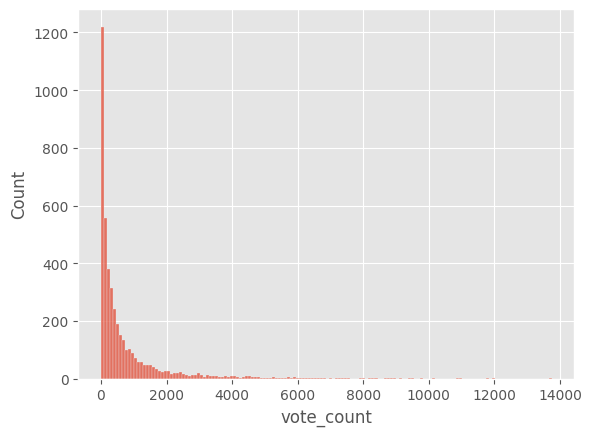

In [55]:
## plotting a histogram of `vote_average` & `vote_count`
sns.histplot(movies['vote_count']);

#### Let's see how many movies have high average ratings but low vote counts

In [56]:
## fetching titles with `vote_count` lower than 50%ile and `vote_average` higher than 50%ile
movies[(movies["vote_count"] <= movies['vote_count'].quantile(q = .5)) & (movies["vote_average"] >= movies['vote_average'].quantile(q = .5))]

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year
95,315011,Shin Godzilla,"[action, adventure, drama, horror, sciencefict...","[from, the, mind, behind, evangelion, come, a,...","[monster, godzilla, giant monster, destruction...","[hirokihasegawa, yutakatakenouchi, satomiishih...",6.5,143,"[cinebazar, tohopictures]",15000000,77000000,"[hideakianno, shinjihiguchi]",2016
312,29193,The Spanish Prisoner,"[crime, drama, mystery, thriller]","[an, employe, of, a, corpor, with, a, lucr, se...","[dialogue, confidence, invention, independent ...","[stevemartin, campbellscott, bengazzara]",7.1,73,"[jeandoumanianproductions, sweetlandfilms, mag...",10000000,13835130,[davidmamet],1997
315,76758,The Flowers of War,"[drama, history, war]","[a, western, find, refug, with, a, group, of, ...","[forced prostitution, child rape]","[christianbale, nini, tongdawei]",7.1,187,"[beijingnewpicturefilmco.ltd., edkofilm, newpi...",94000000,95311434,[zhangyimou],2011
378,4464,Seabiscuit,"[drama, history]","[true, stori, of, the, unders, depressionera, ...","[horse race, american dream, racehorse, great ...","[jeffbridges, davidmccullough, chriscooper]",6.7,216,"[universalpictures, spyglassentertainment, the...",87000000,148336445,[garyross],2003
405,16858,All That Jazz,"[drama, music]","[bob, foss, semiautobiograph, film, celebr, sh...","[show business, film making, tap dancing, movi...","[royscheider, jessicalange, lelandpalmer]",7.3,85,"[twentiethcenturyfoxfilmcorporation, columbiap...",0,37823676,[bobfosse],1979
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4380,39851,Clean,[drama],"[after, lose, her, husband, to, a, heroin, ove...","[addiction, recovering drug addict, estranged ...","[maggiecheung, nicknolte, béatricedalle]",6.7,17,[],0,0,[olivierassayas],2004
4382,36095,Cure,"[crime, horror, mystery, thriller]","[a, wave, of, gruesom, murder, is, sweep, toky...","[japan, prostitute, hotel, based on novel, hal...","[kojiyakusho, masatohagiwara, tsuyoshiujiki]",7.4,63,[daieistudios],20000,99000,[kiyoshikurosawa],1997
4386,9367,El Mariachi,"[action, crime, thriller]","[el, mariachi, just, want, to, play, hi, guita...","[united states–mexico barrier, legs, arms, pap...","[carlosgallardo, jaimedehoyos, petermarquardt]",6.6,238,[columbiapictures],220000,2040920,[robertrodriguez],1992
4387,231617,"Signed, Sealed, Delivered","[comedy, drama, romance, tvmovie]","[sign, seal, deliv, introduc, a, dedic, quarte...","[date, love at first sight, narration, investi...","[ericmabius, kristinbooth, crystallowe]",7.0,6,"[frontstreetpictures, museentertainmententerpr...",0,0,[scottsmith],2013


#### Note: More than 20% of the movies have `vote_count` *lower than 50%ile* but `vote_average` *higher than 50%ile* which makes the overall ratings questionable.

So, since it's not possible to cross-check all the ratings, we'll fetch the `vote_average` for 5 random movies and compare with IMDb** ratings. Such a way, we'll be able to decide how to handle `vote_count` & `vote_average`.

In [57]:
## fetching `vote_average` for five random movies from the dataset
movies[['title', 'vote_average']].sample(5, random_state = 101)

,title,vote_average
897,Mr. Deeds,5.6
1379,The Nativity Story,6.4
141,Pan,5.9
1847,He Got Game,6.7
2869,Dogma,6.8


#### According to IMDb (Manual cross-checking)
* <a href = "https://www.imdb.com/title/tt0261983/?ref_=nv_sr_srsg_0_tt_8_nm_0_q_Session%25209"> Session 9 </a> -> 6.4
* <a href = "https://www.imdb.com/title/tt1294213/?ref_=nv_sr_srsg_0_tt_8_nm_0_q_Solitary%2520Man"> Solitary Man </a> -> 6.3
* <a href = "https://www.imdb.com/title/tt0221218/?ref_=nv_sr_srsg_0_tt_8_nm_0_q_The%2520Glass%2520House"> The Glass House </a> -> 5.8
* <a href = "https://www.imdb.com/title/tt1504320/?ref_=nv_sr_srsg_0_tt_8_nm_0_q_The%2520King%27s%2520Speech"> The King's Speech </a> -> 8.0
* <a href = "https://www.imdb.com/title/tt1663202/?ref_=nv_sr_srsg_0_tt_8_nm_0_q_The%2520Revenant"> The Revenant </a> -> 8.0

In [58]:
## manually calculating the percentage difference b/w TMDb and IMDb ratings
print("IMDb ratings are off from the vote_average in our dataset by: ")
print("--------------------------------------------------------------")

print(f"{movies[['title', 'vote_average']].sample(5, random_state = 101).iloc[0]['title']} : {np.round((6.2 - 6.4)*100/6.4, 2)}%")
print(f"{movies[['title', 'vote_average']].sample(5, random_state = 101).iloc[1]['title']} : {np.round((5.8 - 6.3)*100/6.3, 2)}%")
print(f"{movies[['title', 'vote_average']].sample(5, random_state = 101).iloc[2]['title']} : {np.round((5.4 - 5.8)*100/5.8, 2)}%")
print(f"{movies[['title', 'vote_average']].sample(5, random_state = 101).iloc[3]['title']} : {np.round((7.6 - 8.0)*100/8.0, 2)}%")
print(f"{movies[['title', 'vote_average']].sample(5, random_state = 101).iloc[4]['title']} : {np.round((7.3 - 8.0)*100/8.0, 2)}%")

## mean
print("--------------------------------------------------------------")
print(f"Note: On an average IMDb ratings are off by {np.round(np.mean([np.round((7.3 - 8.0)*100/8.0, 2), np.round((7.6 - 8.0)*100/8.0, 2), np.round((5.4 - 5.8)*100/5.8, 2), np.round((5.8 - 6.3)*100/6.3, 2), np.round((6.2 - 6.4)*100/6.2, 2)]),2)}%.")

IMDb ratings are off from the vote_average in our dataset by: 
--------------------------------------------------------------
Mr. Deeds : -3.13%
The Nativity Story : -7.94%
Pan : -6.9%
He Got Game : -5.0%
Dogma : -8.75%
--------------------------------------------------------------
Note: On an average IMDb ratings are off by -6.36%.


#### We can handle this situation by bucketing the data into different parts based on the `vote_count` column.

#### 4.6.1 Bucketing the `vote_average` column

In [59]:
## creating bins for the vote_average column
bins = [0, 4, 5, 6, 7, 8, 9, 10]

## Create labels for the bins
labels = ['verypoor', 'poor', 'belowaverage', 'average', 'aboveaverage', 'good', 'excellent']  # Define labels for each bin

## creating a new column 'rating_category' based on the bins
movies['rating_category'] = pd.cut(movies['vote_average'], bins=bins, labels=labels, right=False)

In [60]:
## checking the data type of the newly introduced column
movies['rating_category'].dtype

CategoricalDtype(categories=['verypoor', 'poor', 'belowaverage', 'average',
                  'aboveaverage', 'good', 'excellent'],
, ordered=True, categories_dtype=object)

In [61]:
## changing the dtype from category to object for further processes
movies['rating_category'] = movies['rating_category'].astype('object')

In [62]:
## checking if we encountered any NULL value
movies['rating_category'].isnull().sum()

3

In [63]:
## checking if we encountered any NULL value
movies[movies['rating_category'].isnull()]

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year,rating_category
3316,89861,Stiff Upper Lips,[comedy],"[stiff, upper, lip, is, a, broad, parodi, of, ...","[italy, victorian england, young woman]","[georginacates, peterustinov, prunellascales]",10.0,1,[],0,0,[garysinyor],1998,NaN
3791,78373,"Dancer, Texas Pop. 81","[comedy, drama, family]","[four, guy, best, friend, have, grown, up, tog...","[small town, texas]","[breckinmeyer, peterfacinelli, eddiemills]",10.0,1,"[hsxfilms, chaseproductions]",0,565592,[timmccanlies],1998,NaN
4284,40963,Little Big Top,[comedy],"[an, age, out, of, work, clown, return, to, hi...",[independent film],"[sidhaig, richardriehle, melengland]",10.0,1,[flyhighfilms],0,0,[],2006,NaN


In [64]:
## replacing NULL values with `unknown`
movies['rating_category'] = movies['rating_category'].fillna("unknown")

In [65]:
## checking if the replacement is done
movies['rating_category'].isnull().sum()

0

In [66]:
## fetching a random title
movies.sample(1, random_state=101)

,movie_id,title,genres,overview,keywords,cast,vote_average,vote_count,production_companies,budget,revenue,director,release_year,rating_category
897,2022,Mr. Deeds,"[comedy, romance]","[when, longfellow, deed, a, smalltown, pizzeri...","[love letter, new hampshire, ferrari, liar, ci...","[adamsandler, winonaryder, johnturturro]",5.6,644,"[newlinecinema, columbiapicturescorporation, o...",50000000,171269535,[stevenbrill],2002,belowaverage


#### Since the`rating_category` already serves the purpose of quantifying the overall quality of a title, we can now remove both `vote_count` & `vote_average` columns.

In [67]:
## dropping `vote_count` & `vote_average`
movies.drop(['vote_count', 'vote_average'], axis=1, inplace=True)

### 4.7. Dealing with `release_year`

For this recommender system, we're trying to deal with categorical data only. As we've just performed bucketing for the `vote_count` and `vote_average` column, we can do the same for the `release_year` column.

In [68]:
# Early 1900s: 1916 - 1945
# Mid 20th Century: 1946 - 1975
# Late 20th Century: 1976 - 1999
# 21st Century:
    # 2000 - 2005
    # 2006 - 2010
    # 2011 - 2017

def bucketingReleaseYear(year):
    if year <= 1945 and year >= 1916:
        return "early_1990s"
    elif year >= 1946 and year <= 1975:
        return "mid_20th"
    elif year >= 1976 and year <= 1999:
        return "late_20th"
    else:
        return "21st_cen"

In [69]:
## applying the bucketing function to the existing `release_year` column
movies['release_year'] = movies['release_year'].apply(bucketingReleaseYear)

In [70]:
## renaming the column `release_year` -> `release_era`
movies.rename({'release_year': 'release_era'}, axis=1, inplace=True)

### 4.8. Dealing with `budget` and `revenue` column

In [71]:
## statistical information
print(movies['budget'].describe())
print("----------------------------------")
print(movies['revenue'].describe())

count    4.389000e+03
mean     3.113451e+07
std      4.172276e+07
min      0.000000e+00
25%      2.000000e+06
50%      1.600000e+07
75%      4.100000e+07
max      3.800000e+08
Name: budget, dtype: float64
----------------------------------
count    4.389000e+03
mean     8.925949e+07
std      1.683945e+08
min      0.000000e+00
25%      0.000000e+00
50%      2.534500e+07
75%      1.016466e+08
max      2.787965e+09
Name: revenue, dtype: float64


**Note:** Minimum values for both `budget` & `revenue` are 0 that means those are invalid entries.

In [72]:
## fetching movies where either `budget` or `revenue` is 0 or 1
movies.query("budget in [0,1] or revenue in [0,1]")

,movie_id,title,genres,overview,keywords,cast,production_companies,budget,revenue,director,release_era,rating_category
133,7978,The Wolfman,"[drama, horror, thriller]","[lawrenc, talbot, an, american, man, on, a, vi...","[father son relationship, victorian england, r...","[beniciodeltoro, anthonyhopkins, emilyblunt]","[universalpictures, stuberproductions, relativ...",150000000,0,[joejohnston],21st_cen,belowaverage
263,10588,The Cat in the Hat,"[comedy, fantasy, family]","[conrad, and, salli, walden, are, home, alon, ...","[cat, brother sister relationship, boredom, ch...","[mikemyers, dakotafanning, spencerbreslin]","[imagineentertainment, dreamworksskg, universa...",0,0,[bowelch],21st_cen,poor
307,10214,Son of the Mask,"[fantasy, comedy, family, adventure]","[tim, averi, an, aspir, cartoonist, find, hims...","[baby, mask, viking]","[jamiekennedy, alancumming, traylorhoward]","[newlinecinema, pathédistribution]",84000000,0,[lawrenceguterman],21st_cen,verypoor
319,77953,The Campaign,[comedy],"[two, rival, politician, compet, to, win, an, ...","[politics, politician, election campaign, nor...","[willferrell, zachgalifianakis, dylanmcdermott]","[everymanpictures, garysanchezproductions, war...",0,104907746,[jayroach],21st_cen,belowaverage
356,258509,Alvin and the Chipmunks: The Road Chip,"[adventure, animation, comedy, family]","[through, a, seri, of, misunderstand, alvin, s...","[chipmunk, cgi, talking animal, aftercreditsst...","[jasonlee, justinlong, bellathorne]","[regencyenterprises, fox2000pictures, sunswept...",0,233755553,[waltbecker],21st_cen,belowaverage
...,...,...,...,...,...,...,...,...,...,...,...,...
4381,157185,Tin Can Man,[horror],"[recent, dump, by, hi, girlfirend, for, anoth,...",[home invasion],"[michaelparle, emmaelizaregan, patricko'donnell]","[parkfilms, camerastylofilms]",13,0,[ivankavanagh],21st_cen,verypoor
4383,182291,On The Downlow,[drama],"[isaac, and, angel, are, two, young, latino, i...","[confession, hazing, gang member, latino, lgbt...","[tonysancho, michaelcortez, donatocruz]",[iconoclastfilms],0,0,[tadeogarcia],21st_cen,average
4384,124606,Bang,[drama],"[a, young, woman, in, la, is, have, a, bad, da...","[gang, audition, police fake, homeless, actress]","[darlingnarita, petergreene, michaelnewland]","[asylumfilms, fmentertainment, eagleeyefilmsinc.]",0,0,[ashbaron-cohen],late_20th,average
4387,231617,"Signed, Sealed, Delivered","[comedy, drama, romance, tvmovie]","[sign, seal, deliv, introduc, a, dedic, quarte...","[date, love at first sight, narration, investi...","[ericmabius, kristinbooth, crystallowe]","[frontstreetpictures, museentertainmententerpr...",0,0,[scottsmith],21st_cen,aboveaverage


In [73]:
## percentage data
movies.query("budget in [0,1] or revenue in [0,1]").shape[0]*100/movies.shape[0]

28.662565504670766

#### More than 32% of the movies have 0 or 1 in either `budget` or `revenue` column - which mean `budget` and `revenue` columns are way too inconsistent to create any sort of measure from.

In [74]:
## Taking the ratio of movie `revenue` and `budget` and rounding that up to 3 decimal places
np.round(movies.revenue/movies.budget,3)

0       11.764
1        3.203
2        3.595
3        4.340
4        1.093
         ...  
4384       NaN
4385    60.680
4386     9.277
4387       NaN
4388       NaN
Length: 4389, dtype: float64

*Note:* We can see a few `NULL` values. Let's see the overall distribution of the same.

In [75]:
## fetching the statistical information for the ratio `revenue` and `budget`
np.round(movies.revenue/movies.budget,3).describe()

count    3731.0000
mean           inf
std            NaN
min         0.0000
25%         0.6220
50%         2.0770
75%         4.4405
max            inf
dtype: float64

**Note:** There are a few `np.inf` values. Let's replace all those with `np.nan` and then take another look at the statistical information of the `revenue-budget-ratio`

In [76]:
## replacing `np.inf` with `np.nan` and apply `.describe()` to see the statistical infomation of the series
## and for onvenience, rounding it up to 3 decimal places
np.round(pd.Series(np.where(np.round(movies.revenue/movies.budget,3) == np.inf, np.nan, np.round(movies.revenue/movies.budget,3))).describe())

count       3591.0
mean        2657.0
std       142818.0
min            0.0
25%            1.0
50%            2.0
75%            4.0
max      8500000.0
dtype: float64

In [77]:
## fetching the movie with the maximum `revenue-budget-ratio` i.e. 8500000
movies[movies['revenue']/movies['budget'] == 8500000.0]

,movie_id,title,genres,overview,keywords,cast,production_companies,budget,revenue,director,release_era,rating_category
3955,3082,Modern Times,"[drama, comedy]","[the, tramp, struggl, to, live, in, modern, in...","[factory, ambulance, invention, tramp, great d...","[charliechaplin, paulettegoddard, henrybergman]","[unitedartists, charleschaplinproductions]",1,8500000,[charliechaplin],early_1990s,good


#### Apparently, the value in the `budget` column for this particular title is invalid. 

In [78]:
## checking the number of `NULL` values if we decide to proceed to create the `revenue-budget-ratio` column
pd.Series(np.where(np.round(movies.revenue/movies.budget,3) == np.inf, np.nan, np.round(movies.revenue/movies.budget,3))).isnull().sum()

798

In [79]:
## Checking the missing percentage
1036*100/movies.shape[0]

23.604465709728867

**Note:** If we decide to crete a column `revenue-budget-ratio` based on `budget` and `revenue` column, we'll miss out on more than 21% of the original data.

#### Hence, it's not feasible to drop these two columns.

In [80]:
## dropping `budget` and `revenue` columns
movies.drop(['budget', 'revenue'], axis=1, inplace=True)

In [81]:
## checking the head of the DataFrame
movies.head(1)

,movie_id,title,genres,overview,keywords,cast,production_companies,director,release_era,rating_category
0,19995,Avatar,"[action, adventure, fantasy, sciencefiction]","[in, the, 22nd, centuri, a, parapleg, marin, i...","[culture clash, future, space war, space colon...","[samworthington, zoesaldana, sigourneyweaver]","[ingeniousfilmpartners, twentiethcenturyfoxfil...",[jamescameron],21st_cen,aboveaverage


### 4.8. Dealing duplicate rows

In [82]:
## fetching duplicated rows for `title` column
movies[movies.duplicated(subset=['title'], keep = False)].sort_values(by='title')

,movie_id,title,genres,overview,keywords,cast,production_companies,director,release_era,rating_category
1333,268,Batman,"[fantasy, action]","[the, dark, knight, of, gotham, citi, begin, h...","[double life, dc comics, dual identity, chemic...","[jacknicholson, michaelkeaton, kimbasinger]","[polygramfilmedentertainment, theguber-petersc...",[timburton],late_20th,aboveaverage
3976,2661,Batman,"[family, adventure, comedy, sciencefiction, cr...","[the, dynam, duo, face, four, supervillain, wh...","[submarine, dc comics, missile, shark attack, ...","[adamwest, burtward, leemeriwether]","[twentiethcenturyfoxfilmcorporation, dccomics,...",[leslieh.martinson],mid_20th,average
3435,39269,Out of the Blue,[drama],"[denni, hopper, is, a, harddrink, truck, drive...","[punk, independent film, coming of age, teenag...","[dennishopper, raymondburr, sharonfarrell]",[robsonstreet],[dennishopper],late_20th,average
3474,10844,Out of the Blue,[drama],"[ordinari, peopl, find, extraordinari, courag,...","[new zealand, gun rampage, police, independent...","[karlurban, tandiwright, simonferry]",[],[robertsarkies],21st_cen,belowaverage
960,72710,The Host,"[action, adventure, romance, sciencefiction, t...","[a, parasit, alien, soul, is, inject, into, th...","[based on novel, mass murder, dystopia, genoci...","[saoirseronan, dianekruger, jakeabel]","[nickwechslerproductions, openroadfilms, silve...",[andrewniccol],21st_cen,average
2756,1255,The Host,"[horror, drama, sciencefiction]","[gangdu, is, a, dimwit, man, work, at, hi, fat...","[river, mobile phone, bravery, archer, daughte...","[songkang-ho, parkhae-il, baedoona]","[cineclickasia, happinetpictures, cheongeoram,...",[bongjoon-ho],21st_cen,average


#### As we can see from the DataFrame above, even though the titles are same, these movies are different movies made by different filmmakers. 

Hence, we can surely continue with this.

In [83]:
## checking duplicated movies for `movie_id`
movies[movies.duplicated(subset = ['movie_id'])]

,movie_id,title,genres,overview,keywords,cast,production_companies,director,release_era,rating_category


So, we're almost done with data preparation. There's this one last step - we'll merge all the list of strings in all columns (except for `title` and `movie_id`, obviously and convert it to a gaint string and then create a new column `tags` out of it.

### 4.9. Creating `tags` column

In [84]:
movies.columns

Index(['movie_id', 'title', 'genres', 'overview', 'keywords', 'cast',
       'production_companies', 'director', 'release_era', 'rating_category'],
      dtype='object')

In [85]:
## creating the tags column combining all the lists of strings ---- `release_era` and `rating_category` will be added later
movies['tags'] = movies["genres"] + movies["overview"] + movies["cast"] + movies["production_companies"] + movies["director"]

In [86]:
## coverting the list of strings to a gaint text
movies.tags = movies.tags.apply(lambda x: " ".join(x))

In [87]:
## combining `release_era` and `rating_category` with `tags`
movies['tags'] += movies["release_era"] + movies["rating_category"]

In [88]:
## checking `tags` for the first movie (Avatar)
print(movies.head(1)['tags'][0])

action adventure fantasy sciencefiction in the 22nd centuri a parapleg marin is dispatch to the moon pandora on a uniqu mission but becom torn between follow order and protect an alien civil samworthington zoesaldana sigourneyweaver ingeniousfilmpartners twentiethcenturyfoxfilmcorporation duneentertainment lightstormentertainment jamescameron21st_cenaboveaverage


*Note*: It's better to a keep of copy of the cleaned dataset. Although we can simple to `.copy()`, we'll export a `.csv` file for future use.

### 4.10. Exporting the cleaned DataFrame as a `.csv` file

In [89]:
## exporting the DataFrame as a `.csv` file for future use
movies.to_csv("TMDb-movies-cleaned.csv", index=False)

## 5. Data Exploration

In [90]:
## exploring genres for counts of titles
movies['genres'].explode().value_counts()

genres
drama             2112
comedy            1569
thriller          1190
action            1076
romance            819
adventure          765
crime              646
sciencefiction     508
horror             481
family             460
fantasy            408
mystery            334
animation          215
history            191
music              173
war                139
documentary         91
western             73
foreign             21
tvmovie              5
                     2
Name: count, dtype: int64

In [91]:
## fetching top 10 directors with most number of titles made
movies.director.explode().value_counts()[:10]

director
stevenspielberg     27
woodyallen          21
martinscorsese      21
clinteastwood       19
ridleyscott         16
robertrodriguez     16
rennyharlin         15
stevensoderbergh    15
timburton           14
oliverstone         14
Name: count, dtype: int64

In [92]:
## fetching number of titles by `release_era`
movies.release_era.value_counts()

release_era
21st_cen       3147
late_20th      1048
mid_20th        161
early_1990s      33
Name: count, dtype: int64

In [93]:
## fetching number of titles by `rating_category`
movies.rating_category.value_counts()

rating_category
average         1881
belowaverage    1185
aboveaverage     859
poor             285
verypoor         104
good              71
unknown            3
excellent          1
Name: count, dtype: int64

In [94]:
## fetching number of titles by `production_company`
movies.production_companies.explode().value_counts()

production_companies
warnerbros.                           313
universalpictures                     303
paramountpictures                     278
twentiethcenturyfoxfilmcorporation    213
                                      205
                                     ... 
lastwaltzinc.                           1
littlebigfilmcompany                    1
abundantproductions                     1
faithvs.fateproductions                 1
fairandsquareproductions                1
Name: count, Length: 4691, dtype: int64

In [95]:
## fetching number of titles by `cast`
movies.cast.explode().value_counts()

cast
robertdeniro              45
samuell.jackson           35
brucewillis               35
nicolascage               34
mattdamon                 34
                          ..
jerryferrara               1
dabneycoleman              1
josefsommer                1
emiliorivera               1
hannahendicott-douglas     1
Name: count, Length: 5169, dtype: int64

## 6. Model Building - CountVectorizer

### Using Word Tokenization in Movie Recommender System

In our movie recommender system, we'll utilize word tokenization to break down textual data into meaningful features. This process involves:

1. **Data Preprocessing:** Removing noise and irrelevant information from text data. *(already done)*
2. **Tokenization:** Converting text features into tokenized vectors using `CountVectorizer` or `TfidfVectorizer`.
3. **Vector Space Representation:** Transforming tokenized data into numerical vectors.
4. **Similarity Calculation:** Computing similarity scores (e.g., cosine similarity) to recommend movies based on textual similarities.

By leveraging word tokenization, we enhance the system's ability to generate relevant and personalized movie recommendations.

#### Therefore, We'll first use <a href = "https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html"> CountVectorizer </a>.

### 6.1 Using `CountVectorizer`

In [96]:
## creating an instance of CountVectorizer
cv = CountVectorizer(stop_words="english", max_features=10000)

**Note:**
- Stop words are common words like "the," "is," and "at" that are often removed from text during analysis because they carry little meaning and can be found frequently across documents. Removing stop words can help reduce the dimensionality of text data and improve the performance of machine learning models by focusing on more meaningful words that carry important semantic information.
- Here, we're only considering most frequently occurred 10,000 words to save computation needs.

In [97]:
## fitting the text data and saving it
cv_matrix = cv.fit_transform(movies['tags'])

*Note:* `sklearn.feature_extraction.text.CountVectorizer` returns a sparse matrix by default.

#### Why is cosine distance used instead of `Euclidian distance`?
We'll use cosine distance instead of Euclidean distance for high-dimensional data because cosine distance is more effective in capturing meaningful similarities between data points in such scenarios. This is because cosine distance considers the angles between vectors rather than their absolute magnitudes, making it less sensitive to the curse of dimensionality, data sparsity, and irrelevant dimensions.

#### *Note:* As we know, similary is reversely proportional to distance, we'll use `cosine_similarity()` instead of `cosine_distance()` so that we can quickly fetch titles with **HIGHER** similarity score.

In [98]:
## calculating similarities for each movie with others in the entire dataset
cos_sim = cosine_similarity(X = cv_matrix)

In [99]:
## checking the shape of the matrix calculated by cosine similarity
cos_sim.shape

(4389, 4389)

*Note*: `cos_sim` is a square matrix since each movie has a similarity score for every other movie in the dataset.

#### We have successfully calculated cosine_similarity for each movie. Now, we have to create a function that will take a movie title as input and spit out five most similar movie based on the similarity metric we created.

In [100]:
## function to get the indices of the top five most similar movies
def getRecommendedMovies(movie_title, metric = cos_sim):
    index_position = movies.query(f"title == '{movie_title}'").index[0]
    count = 0
    similar_movie_indices = []
    for i in range(metric[index_position].shape[0]):
        if metric[index_position][i] in np.sort(metric[index_position])[-6:-1]:
            count += 1
            if count < 6:
                # print(movies.title.iloc[i])
                similar_movie_indices.append(i)
    return similar_movie_indices

In [101]:
## function to fetch movie posters from the official TMDb website using TMDb Developer API
def fetch_poster(movie_id, api = "6700d8b244e37ebf55d8ff2c605c02ce"):
    url = "https://api.themoviedb.org/3/movie/{}?api_key={}".format(movie_id, api)
    data = requests.get(url)
    data = data.json()
    poster_path = data['poster_path']
    full_path = "https://image.tmdb.org/t/p/w500/" + poster_path
    return full_path

In [102]:
## function to fetch movies with posters
def plotMovieCovers(movie_list):
    # creating a grid of subplots with 2 rows and 1 column to display 5 movie posters in a row
    fig, axes = plt.subplots(1, 5, figsize = (25, 5), facecolor = '#1C1D20')
    for i in range(5):
        url = fetch_poster(movie_list[i])
        response = requests.get(url)
        img = Image.open(BytesIO(response.content))
        # displaying movie posters on axes one by one
        axes[i].imshow(img)
        # hiding axis labels
        axes[i].axis('off');

In [103]:
## function to get recommender movies with posters
def recommendMoviesWposters(title, metric = cos_sim):
    results = getRecommendedMovies(title, metric)
    plotMovieCovers(movies.iloc[results]['movie_id'].to_list())

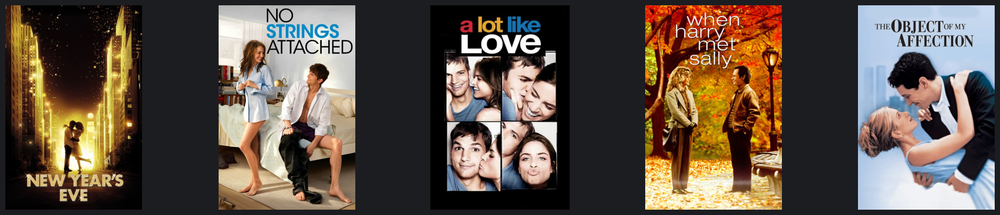

In [104]:
## fetching recommended movies for a popular title called `Friends with Benefits` which is romantic comedy
recommendMoviesWposters("Friends with Benefits")

#### - Here, the recommender system works commendably well. Speaking from personal experience, both `No Strings Attached` and `Friends with Benefits` share a very similar storyline.

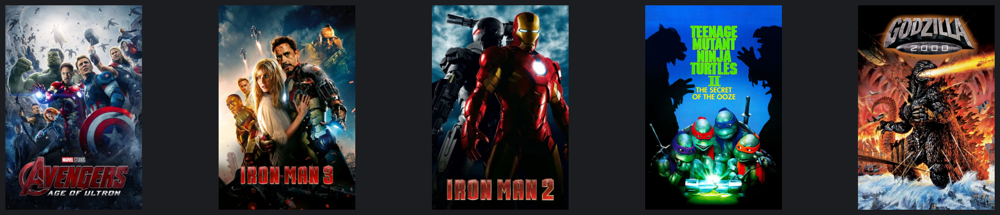

In [105]:
## fetching recommended movies for a popular title called `Iron Man` which is the pioneer of MCU Infinity Saga
recommendMoviesWposters("Iron Man")

#### - Although the first three suggestions are right on track but the last two are a little off.

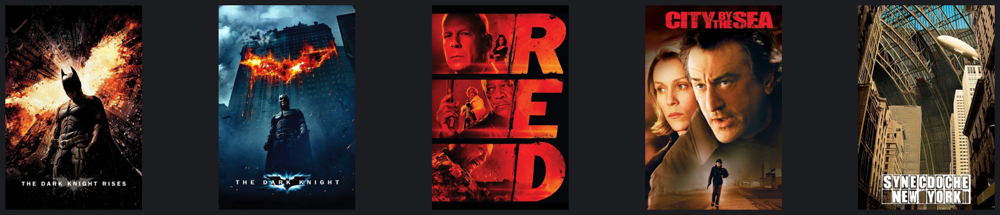

In [106]:
## fetching recommended movies for a popular title called `Batman Begin` which is the first movie of Dark Knight Trilogy by Christopher Nolan
recommendMoviesWposters("Batman Begins")

#### - Likewise the first two suggestions are right on track but the last three are a little off.

#### Note: Although our recommender system works well, there are a few hicups here and there.

We can improve this by manually assigning weights to different columns like `keywords`, `director` and `ratings_category`.

### 6.2. Assigning weights to columns

#### First we have to understand how Tokenization works. So,

#### CountVectorizer Matrix Creation

`CountVectorizer` is used to convert a collection of text documents into a matrix of token counts. Here's how it works:

1. **Tokenization:** It first tokenizes the text by breaking it into individual words or tokens.
2. **Vocabulary Building:** It builds a vocabulary of unique tokens from the tokenized text.
3. **Counting Tokens:** For each document, it counts the occurrences of each token in the vocabulary.
4. **Matrix Creation:** Finally, it creates a matrix where rows represent documents, columns represent tokens from the vocabulary, and each cell contains the count of the corresponding token in the respective document.

This matrix is a sparse representation where most cells are zero, suitable for further processing in machine learning algorithms like clustering or classification.


In [107]:
## fetching all columns of the DataFrame
movies.columns

Index(['movie_id', 'title', 'genres', 'overview', 'keywords', 'cast',
       'production_companies', 'director', 'release_era', 'rating_category',
       'tags'],
      dtype='object')

#### Suppose, you've just finished watching Se7en which is a David Fincher movie starring Brad Pitt and Morgan Freeman, you loved the movie. It's highly likely that would also like other David Fincher movies in the same genres and storyline. We'll use the same logic.

We'll put emphasis on `genres`, `keywords`, `director` and of course, `rating_category` (because it's unlike if somebody watches a more than 7.5-rated movies and then get a recommendation for a 5-rated movie and actually like it).

#### Assigning weights:
Assigning is simple. We just have to take values from that particular column multiple (subject to assigned weight) times while creating the gaint text of tags.

In [108]:
## taking twice `keywords` and `genres` and thrice `director`
movies['tags_new'] = movies['genres']*2 + movies['overview'] + movies['keywords']*2 + movies['cast'] + movies['production_companies'] + movies['director']*3

In [109]:
## taking `rating_category` twice
movies['tags_new'] += movies['rating_category'].apply(lambda x: [x]*2)

In [110]:
## creating new `tags_new` column
movies['tags_new'] = movies['tags_new'].apply(lambda x: " ".join(x)) + " " + movies['release_era']

### 6.3. Improved Model - TfidfVectorizer

Let's explore how <a href = "https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html"> TfidfVectorizer </a> works:

* **Term Frequency (TF):** Captures how often a word appears within a document.
* **Inverse Document Frequency (IDF):** Adjusts for the influence of common words.

  - **Document Frequency (DF):** Number of documents containing the word.
  - **Total Documents (N):** Total documents in the corpus.
  - **IDF Formula:** `IDF = log(N / DF) + 1`

* **Tf-idf Weight:** Combines TF and IDF to represent a word's relative importance.

Tf-idf Vectorizer creates a sparse matrix where:

* Rows represent documents.
* Columns represent unique words.
* Cell values hold the corresponding Tf-idf weights.

**Note**: This's why taking values for a few columns multiple times helps us increase **Term Frequency (TF)** which lead to increased Tf-idf score.

In [111]:
## creating a TfidfVectorizer object
tfidf = TfidfVectorizer(stop_words="english", max_features = None, ngram_range=(1,2), smooth_idf=False)

*Note:* Although setting`max_feature` to `None` is computationally expensive, the upside is this is just a one-time excercise, whenever we'll call a function to get recommendations, we'll have a ready-to-go matrix in handy.

In [112]:
## fitting the new `tags_new` column to the TfidfVectorizer object
tfidf_matrix = tfidf.fit_transform(movies['tags_new'])

#### By default, "l2" normalization is applied on TfidfVectorizer object. Hence, the cosine similarity between two vectors is just their dot product. And, <a href= "https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.linear_kernel.html"> linear_kernel() </a> computes the linear kernel between two matrices or arrays. The linear kernel between two u and v is defined as the dot product of the vectors, often denoted as <u, v>.

In [113]:
## calculating cosine similary score off the sparse matrix returned by the TfidfVectorizer object
linkernel = linear_kernel(tfidf_matrix)

### 6.4. Fetching Final Recommendations

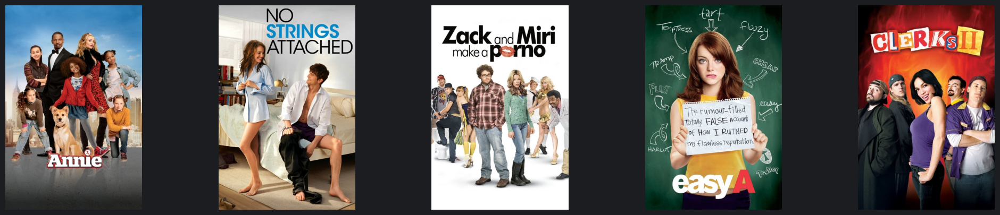

In [114]:
## romantic-comedy
recommendMoviesWposters("Friends with Benefits", linkernel)

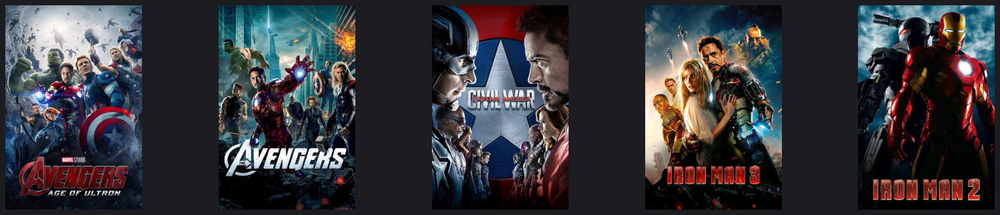

In [115]:
## Marvel Cinematic Universe
recommendMoviesWposters("Iron Man", metric = linkernel)

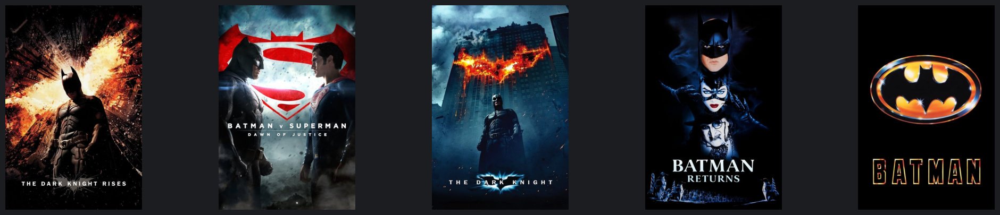

In [116]:
## DC Universe
recommendMoviesWposters("Batman Begins", linkernel)

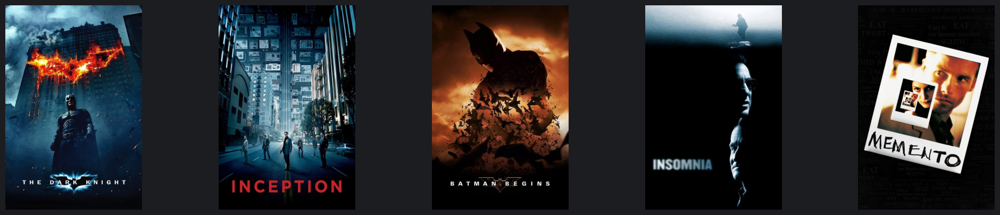

In [117]:
## From Chris Nolan
recommendMoviesWposters("The Prestige", linkernel)

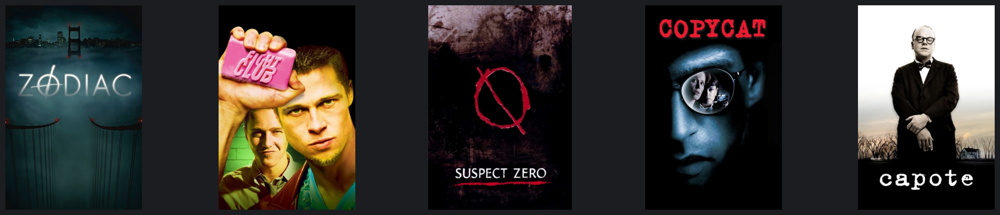

In [118]:
## psychological thriller
recommendMoviesWposters("Se7en", metric = linkernel)

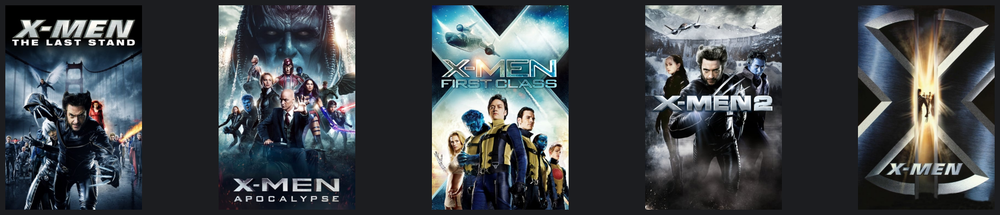

In [119]:
## X-Men
recommendMoviesWposters("The Wolverine", metric = linkernel)

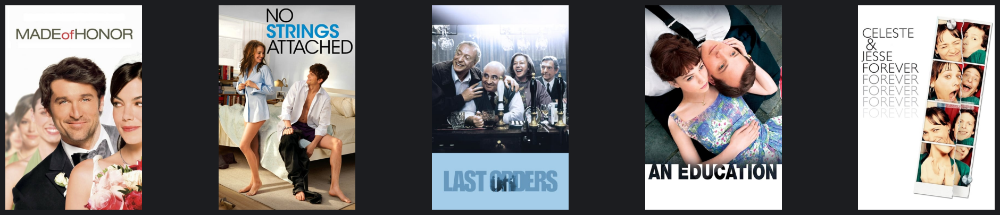

In [120]:
## romantic-drama
recommendMoviesWposters("One Day", metric = linkernel)

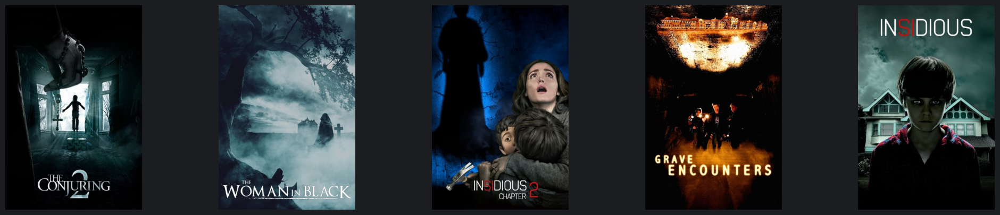

In [121]:
## horror
recommendMoviesWposters("The Conjuring", metric = linkernel)

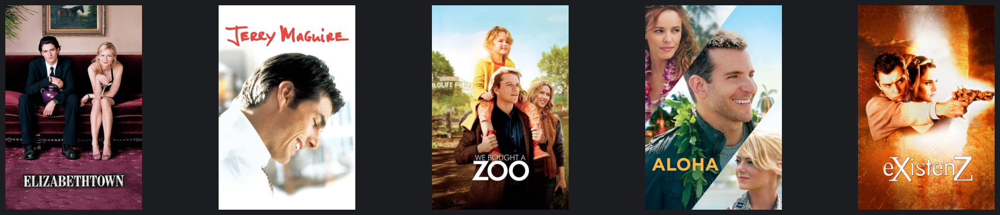

In [122]:
## drama
recommendMoviesWposters("Vanilla Sky", linkernel)

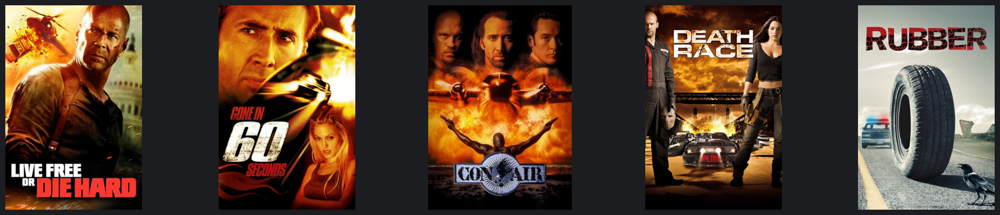

In [123]:
## action
recommendMoviesWposters("Knight and Day", linkernel)

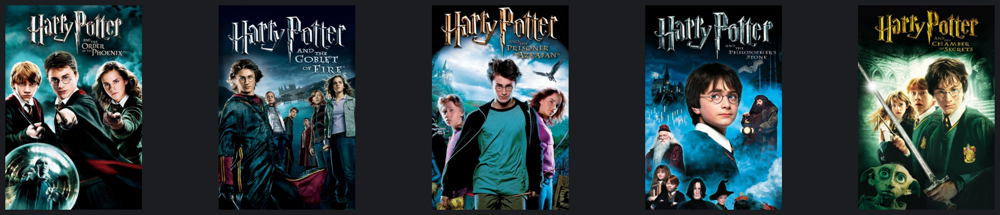

In [124]:
## harry potter franchise
recommendMoviesWposters("Harry Potter and the Half-Blood Prince", linkernel)

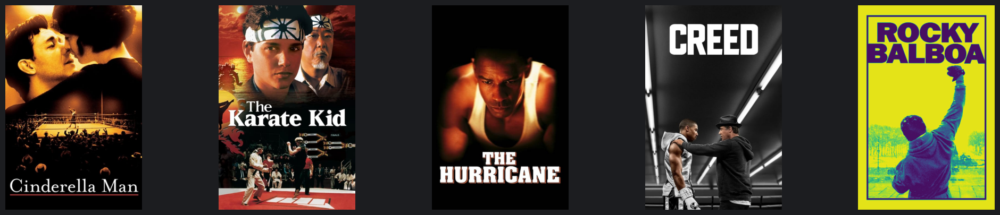

In [125]:
## sports-drama
recommendMoviesWposters("Rocky", metric = linkernel)

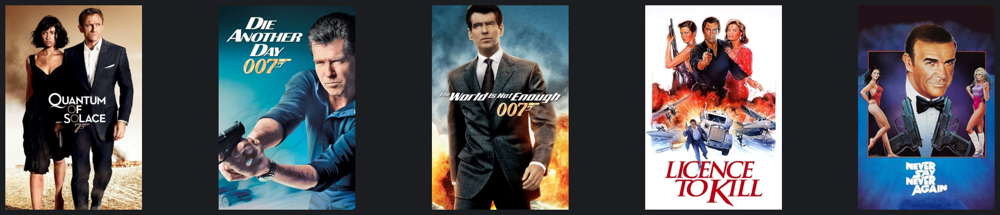

In [126]:
## James Bond Franchise
recommendMoviesWposters("Casino Royale", linkernel)

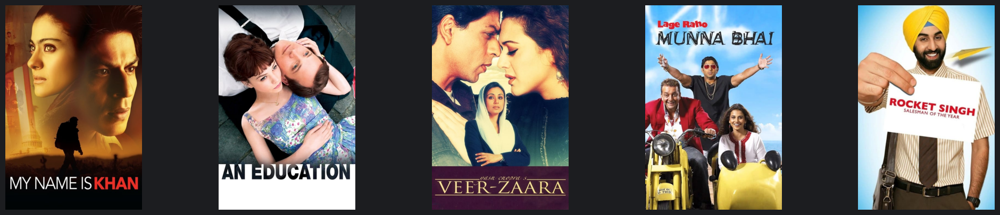

In [127]:
## romantic
recommendMoviesWposters("Jab Tak Hai Jaan", linkernel)

#### As we can see, the Recommender System work pretty well across different genres. But there a few scenarios where it doesn't performs that well which is discussed in the later of the notebook.

### 6.5. Limitations

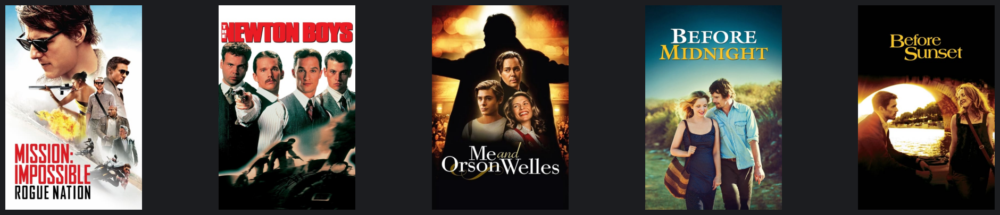

In [128]:
recommendMoviesWposters("Before Sunrise", linkernel)

#### `Before Sunrise` follows an American man and a French woman who meet by chance in Europe, spending a magical night in Vienna before facing the uncertainty of what tomorrow holds. On the contrary, `Mission: Impossible - Rogue Nation` and `The Newton Boys` are two completely different movies. The similary between `Before Sunrise` and `Mission: Impossible - Rogue Nation` is that Ethan Hawk stared in `Before Sunrise` and the lead character of `Mission: Impossible - Rogue Nation` is Ethan Hunt. Likewise, in `The Newton Boys` one of the stars is Ethan Hawk.

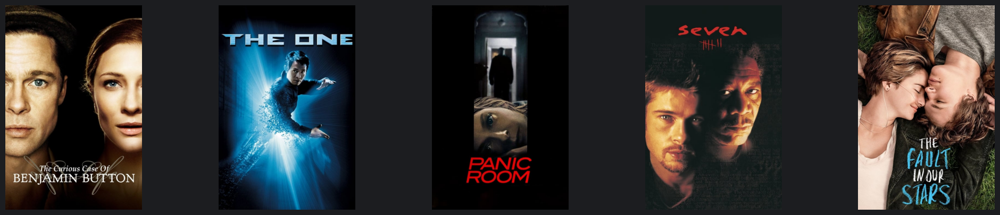

In [129]:
recommendMoviesWposters("Fight Club", metric = linkernel)

#### Similarly, the movie `The Fault in Our Stars` is a completely irrelevant movie in the context of `Fight Club`. 

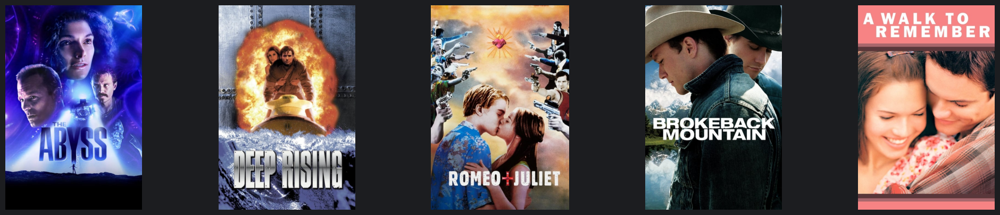

In [130]:
recommendMoviesWposters("Titanic", metric = linkernel)

#### Likwise, in the context of `Titanic` both `The Abyss` and `Deep Rising` are irrelevant. The similarity between three movies is a few keywords like `oceans` and `ship`.

### Note: Future Improvements

In this project, I have successfully built a movie recommender system. However, I have identified some flaws in its performance. In the upcoming build of this recommender system, I plan to rectify these flaws by implementing NLP (Natural Language Processing) and deep learning techniques. This will enhance the system's accuracy and recommendation quality. Stay tuned for the improved version!

## Thanks for making it this far. 